## Decipher

In [1]:
#!pip install scdecipher

In [1]:
import warnings; warnings.filterwarnings("ignore")

In [90]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import scanpy as sc
import anndata
import pandas as pd
import os

In [13]:
import matplotlib as mpl
mpl.rcParams.update({'font.size': 8, 'svg.fonttype': 'none'})
mpl.rcParams['axes.titlesize'] = 8
mpl.rcParams['xtick.labelsize'] = 8  # Colorbar tick label size
mpl.rcParams['ytick.labelsize'] = 8  # Colorbar tick label size

In [91]:
import decipher as dc
dc.pl.activate_journal_quality()

In [92]:
figure_dir = "/burg/iicd/users/qc2358/Kinase_project/CRISPRI_Figures/NTC_analysis/Decipher"
if not os.path.exists(figure_dir):
    os.makedirs(figure_dir)

### 1. Prepare data

In [16]:
adata = sc.read_h5ad('/burg/iicd/users/qc2358/Kinase_project/cds_2000.h5ad')
adata

AnnData object with n_obs × n_vars = 166061 × 56648
    obs: 'P7', 'P5', 'sample', 'n.umi', 'cell_ID', 'RT', 'Lig', 'new_cell', 'oligo', 'total_reads.x', 'total_hash_umis_per_cell_ID', 'top_to_second_best_ratio', 'treatment', 'log10.umi', 'percent_mito', 'sgRNA', 'total_reads.y', 'sgRNA_proportion', 'total_sgrna_read_per_cell', 'rank', 'top_to_second', 'second_to_third', 'third_to_next', 'top_proportion', 'second_proportion', 'third_proportion', 'top_sg', 'second_sg', 'third_sg', 'gene', 'second_sg_gene', 'third_sg_gene', 'cell', 'RT_lig', 'num_genes_expressed', 'Size_Factor', 'gene_id', 'replicate', 'g1s_score', 'g2m_score', 'proliferation_index', 'dose', 'UMAP1', 'UMAP2', 'PCA_Cluster', 'dosage'
    var: 'features'

In [93]:
NTC = adata[adata.obs["gene_id"] == "NTC"]
NTC

View of AnnData object with n_obs × n_vars = 3062 × 56648
    obs: 'P7', 'P5', 'sample', 'n.umi', 'cell_ID', 'RT', 'Lig', 'new_cell', 'oligo', 'total_reads.x', 'total_hash_umis_per_cell_ID', 'top_to_second_best_ratio', 'treatment', 'log10.umi', 'percent_mito', 'sgRNA', 'total_reads.y', 'sgRNA_proportion', 'total_sgrna_read_per_cell', 'rank', 'top_to_second', 'second_to_third', 'third_to_next', 'top_proportion', 'second_proportion', 'third_proportion', 'top_sg', 'second_sg', 'third_sg', 'gene', 'second_sg_gene', 'third_sg_gene', 'cell', 'RT_lig', 'num_genes_expressed', 'Size_Factor', 'gene_id', 'replicate', 'g1s_score', 'g2m_score', 'proliferation_index', 'dose', 'UMAP1', 'UMAP2', 'PCA_Cluster', 'dosage'
    var: 'features'

In [94]:
# Check if X is count matrix
print(NTC.X)

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 6352202 stored elements and shape (3062, 56648)>
  Coords	Values
  (0, 22)	1.0
  (0, 74)	1.0
  (0, 101)	1.0
  (0, 105)	1.0
  (0, 109)	2.0
  (0, 114)	1.0
  (0, 151)	1.0
  (0, 192)	1.0
  (0, 199)	2.0
  (0, 243)	1.0
  (0, 249)	1.0
  (0, 254)	1.0
  (0, 270)	3.0
  (0, 345)	1.0
  (0, 372)	1.0
  (0, 417)	1.0
  (0, 429)	1.0
  (0, 433)	2.0
  (0, 452)	12.0
  (0, 456)	1.0
  (0, 470)	1.0
  (0, 510)	1.0
  (0, 511)	1.0
  (0, 518)	1.0
  (0, 531)	1.0
  :	:
  (3061, 21721)	1.0
  (3061, 23365)	1.0
  (3061, 24185)	1.0
  (3061, 24823)	1.0
  (3061, 27171)	1.0
  (3061, 27720)	1.0
  (3061, 27751)	1.0
  (3061, 28946)	4.0
  (3061, 34533)	1.0
  (3061, 35099)	2.0
  (3061, 35415)	1.0
  (3061, 35532)	2.0
  (3061, 35843)	1.0
  (3061, 36382)	1.0
  (3061, 36744)	1.0
  (3061, 38284)	1.0
  (3061, 38975)	2.0
  (3061, 40625)	1.0
  (3061, 41586)	1.0
  (3061, 43823)	1.0
  (3061, 44692)	3.0
  (3061, 47307)	1.0
  (3061, 49181)	1.0
  (3061, 52240)	1.0
  (3061, 5412

In [95]:
df = pd.read_csv('/burg/iicd/users/qc2358/Kinase_project/Tcell_dose_diff_test.csv')
T_cell_dose_gene = df[(df['term'] == 'dose') & (df['q_value'] < 0.05)]['gene_short_name']
T_cell_dose_gene

13          GCLC
16        NIPAL3
31           BAD
34          LAP3
52        KLHL13
          ...   
27814      ORAI1
27847      CISD3
27850      DDX52
27898    HELLPAR
27901       CDR1
Name: gene_short_name, Length: 1768, dtype: object

In [96]:
NTC = NTC[:, NTC.var_names.isin(T_cell_dose_gene)]
NTC

View of AnnData object with n_obs × n_vars = 3062 × 1768
    obs: 'P7', 'P5', 'sample', 'n.umi', 'cell_ID', 'RT', 'Lig', 'new_cell', 'oligo', 'total_reads.x', 'total_hash_umis_per_cell_ID', 'top_to_second_best_ratio', 'treatment', 'log10.umi', 'percent_mito', 'sgRNA', 'total_reads.y', 'sgRNA_proportion', 'total_sgrna_read_per_cell', 'rank', 'top_to_second', 'second_to_third', 'third_to_next', 'top_proportion', 'second_proportion', 'third_proportion', 'top_sg', 'second_sg', 'third_sg', 'gene', 'second_sg_gene', 'third_sg_gene', 'cell', 'RT_lig', 'num_genes_expressed', 'Size_Factor', 'gene_id', 'replicate', 'g1s_score', 'g2m_score', 'proliferation_index', 'dose', 'UMAP1', 'UMAP2', 'PCA_Cluster', 'dosage'
    var: 'features'

In [97]:
NTC.obs['dosage'] = pd.Categorical(NTC.obs['dosage'], categories=['0', '0.25', '0.5', '1'], ordered=True)

/local/ipykernel_867822/574772036.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  NTC.obs['dosage'] = pd.Categorical(NTC.obs['dosage'], categories=['0', '0.25', '0.5', '1'], ordered=True)


In [98]:
dosage_colors = {
    "0": "#023047",
    "0.25": "#219EBC",
    "0.5": "#FFD166",
    "1": "#FF7F11",
}

### 2. Model training

Epoch 74 (batch 43/43) | | train elbo: 1386.40 (last epoch: 1387.11) | val ll: 1357.34:   7%|▋         | 74/1000 [01:12<15:07,  1.02it/s]2025-06-02 15:11:17,155 | INFO : Early stopping has been triggered.
2025-06-02 15:11:17,178 | INFO : Added `.obsm['decipher_v']`: the Decipher v space.
2025-06-02 15:11:17,178 | INFO : Added `.obsm['decipher_z']`: the Decipher z space.
2025-06-02 15:11:17,179 | INFO : Saving decipher model with run_id 2025-06-02-15-11-17-coherent-cheerful-parent.


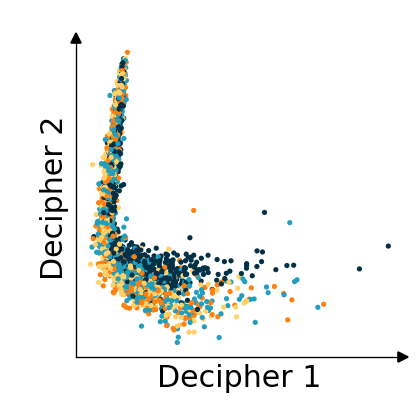

... storing 'P7' as categorical
... storing 'P5' as categorical
... storing 'sample' as categorical
... storing 'RT' as categorical
... storing 'Lig' as categorical
... storing 'oligo' as categorical
... storing 'treatment' as categorical
... storing 'sgRNA' as categorical
... storing 'top_sg' as categorical
... storing 'second_sg' as categorical
... storing 'third_sg' as categorical
... storing 'gene' as categorical
... storing 'second_sg_gene' as categorical
... storing 'third_sg_gene' as categorical
... storing 'RT_lig' as categorical
... storing 'gene_id' as categorical
... storing 'replicate' as categorical
/burg/iicd/users/qc2358/decipher/decipher/tools/_decipher/data.py:85: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#

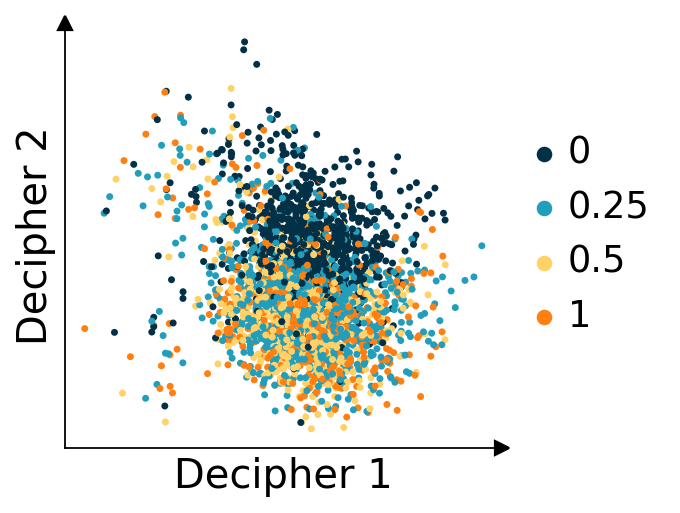

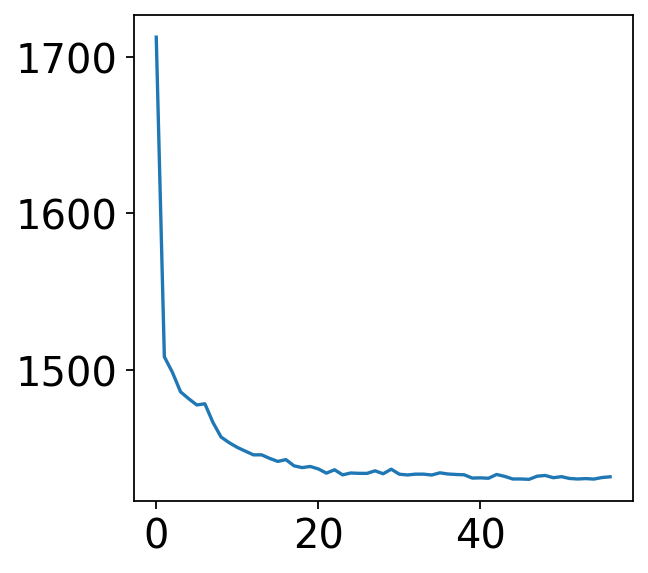

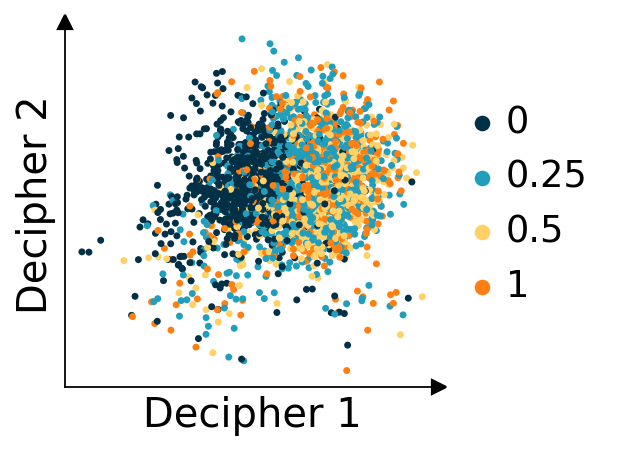

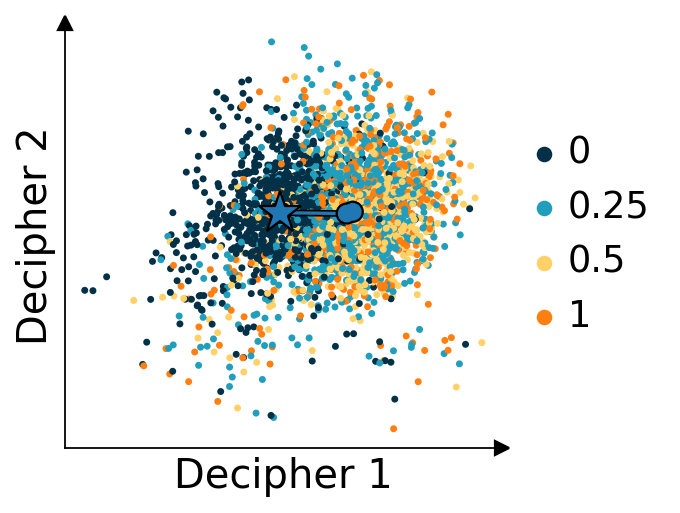

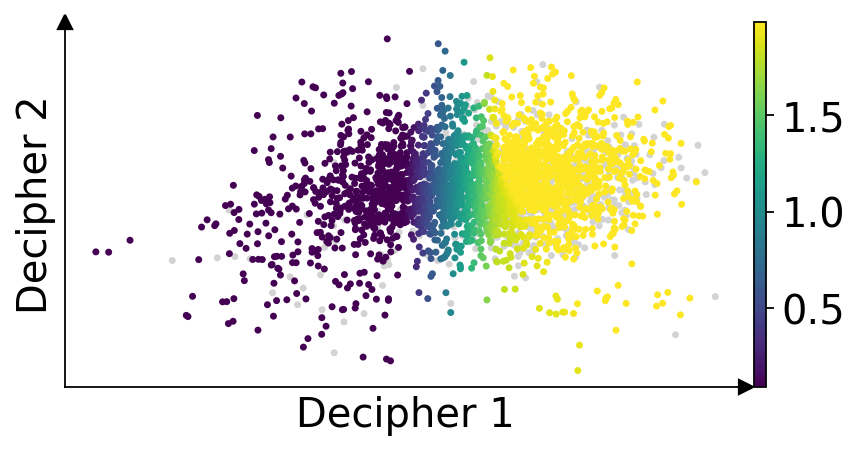

...

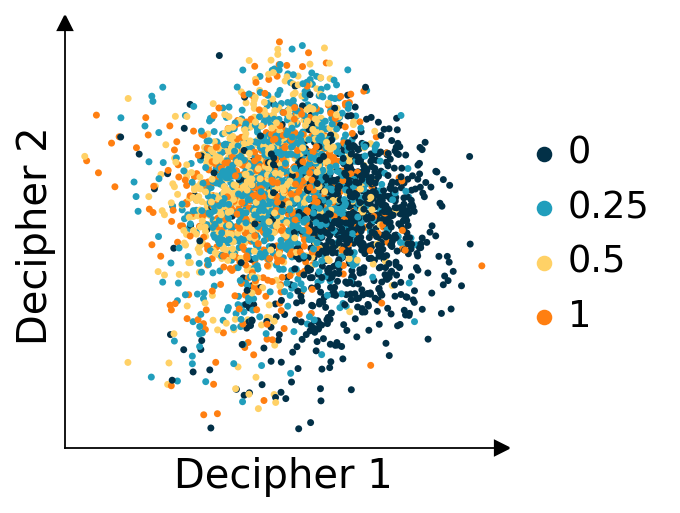

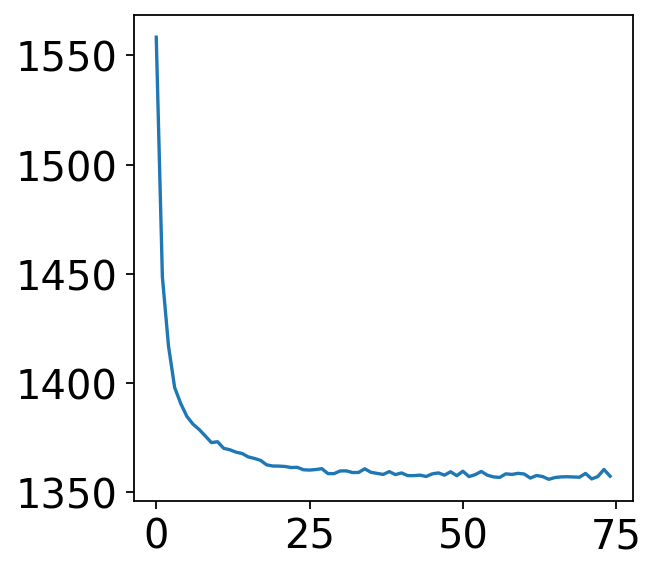

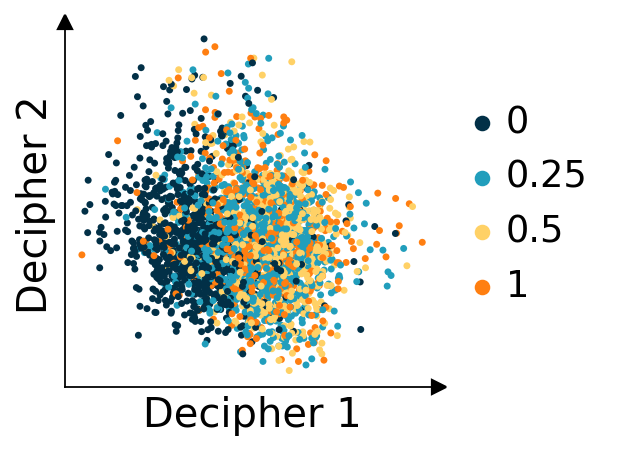

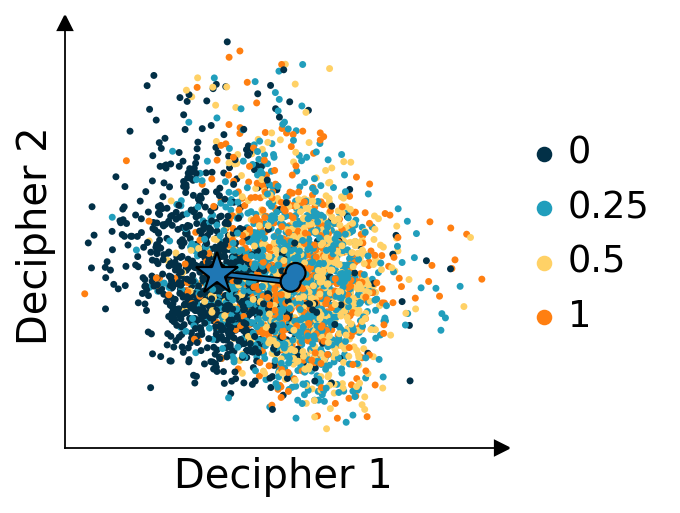

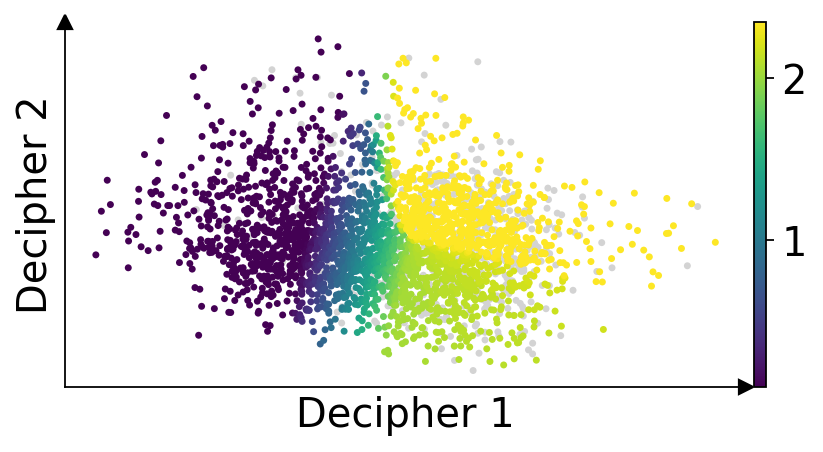

In [23]:
# Try different seeds
fig_list = []
for i in range(20):

    print(i)
    color_palette = dosage_colors
    decipher_config = dc.tl.DecipherConfig(seed=i)  # optional Decipher config
    
    d3, val3 = dc.tl.decipher_train(
        NTC, decipher_config, plot_kwargs={"color": "dosage", "palette": color_palette}, plot_every_k_epochs=1, device="cuda"
    )

    fig, ax = plt.subplots()
    ax.plot(val3)
    fig_list.append(fig)
    dc.tl.decipher_rotate_space( NTC, v1_col="dosage", v1_order=["0", "1"],)
    fig1 = dc.pl.decipher(NTC, ["dosage"], palette=color_palette, figsize=(3, 3))
    fig_list.append(fig1)
    NTC.obs['decipher_clusters'] = NTC.obs["dosage"]
    dc.tl.trajectories(
        NTC,
        dc.tl.TConfig("dosage_class", start_cluster_or_marker='0', end_cluster_or_marker='1')
    )
    dc.pl.trajectories(NTC, "dosage", palette=dosage_colors)
    dc.tl.decipher_time(NTC)
    fig2 = dc.pl.decipher_time(NTC,figsize=(6, 3))
    fig_list.append(fig2)

Epoch 85 (batch 43/43) | | train elbo: 1381.23 (last epoch: 1380.82) | val ll: 1384.47:   8%|▊         | 85/1000 [01:22<14:52,  1.03it/s]2025-06-02 16:55:18,091 | INFO : Early stopping has been triggered.
2025-06-02 16:55:18,107 | INFO : Added `.obsm['decipher_v']`: the Decipher v space.
2025-06-02 16:55:18,108 | INFO : Added `.obsm['decipher_z']`: the Decipher z space.
2025-06-02 16:55:18,109 | INFO : Saving decipher model with run_id 2025-06-02-16-55-18-adaptive-sad-filet.


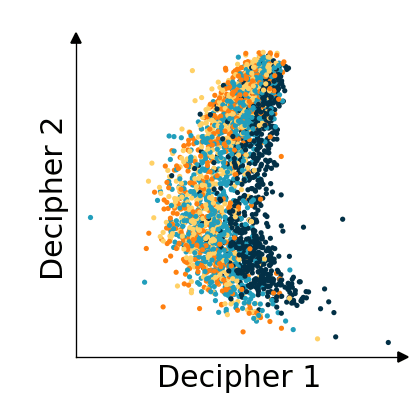

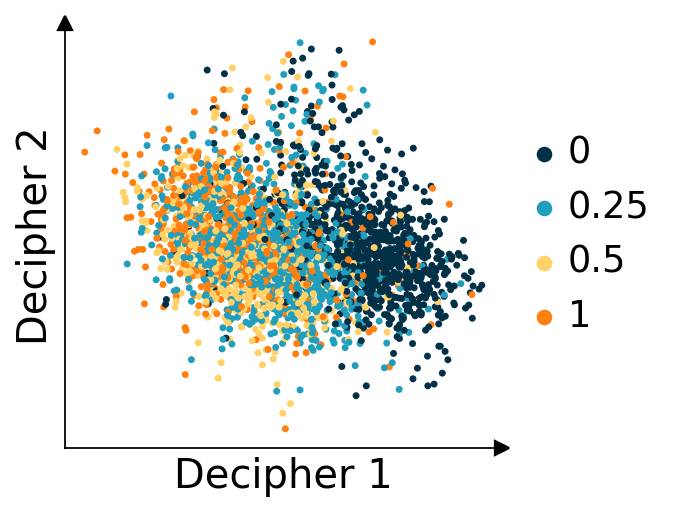

In [110]:
decipher_config = dc.tl.DecipherConfig(seed=8)  # optional Decipher config

d3, val3 = dc.tl.decipher_train(
    NTC, decipher_config, plot_kwargs={"color": "dosage", "palette": dosage_colors}, plot_every_k_epochs=1, device="cuda"
)

/burg/iicd/users/qc2358/decipher/decipher/tools/_decipher/data.py:85: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(os.path.join(full_path, 

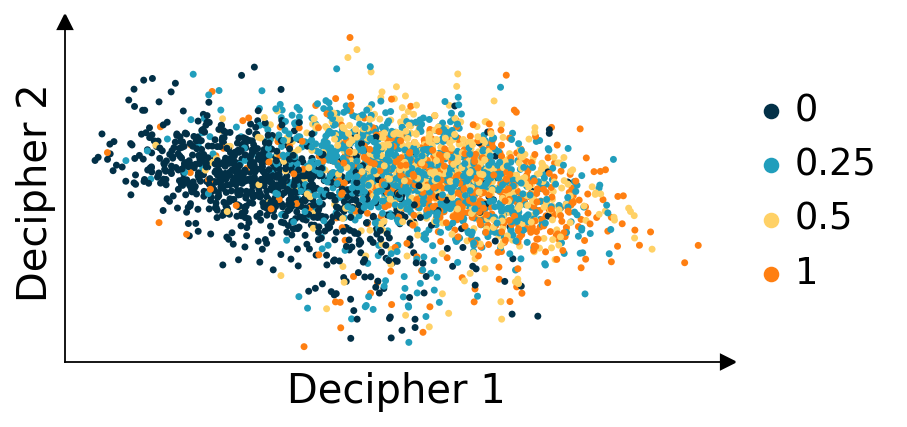

In [111]:
dc.tl.decipher_rotate_space(
    NTC,
        v1_col="dosage",
        v1_order=["0", "1"],
    )
dc.pl.decipher(NTC, ["dosage"], palette=dosage_colors, figsize=(6, 3))
plt.tight_layout()
plt.savefig(os.path.join(figure_dir, 'dose_decipher.png'), dpi=300)
plt.savefig(os.path.join(figure_dir, 'dose_decipher.svg'), dpi=300)

/burg/iicd/users/qc2358/decipher/decipher/tools/trajectory_inference.py:364: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cells_locations.groupby("cluster_id").count()[0] > t_config.min_cell_per_cluster
/burg/iicd/users/qc2358/decipher/decipher/tools/trajectory_inference.py:366: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_locations = cells_locations.groupby("cluster_id").mean()
2025-06-02 16:55:29,116 | INFO : Trajectory dosage_class : ['0', '0.25', '0.5', '1'])
2025-06-02 16:55:29,119 | INFO : Added trajectory dosage_class to `adata.uns['decipher']['trajectories']`.


2025-06-02 16:55:29,236 | INFO : Added `.obs['decipher_time']`: the decipher time of each cell.


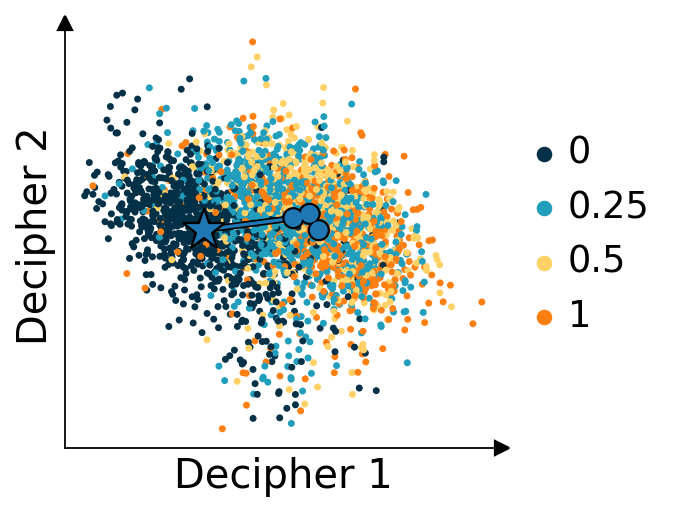

In [112]:
NTC.obs['decipher_clusters'] = NTC.obs["dosage"]
dc.tl.trajectories(
    NTC,
    dc.tl.TConfig("dosage_class", start_cluster_or_marker='0', end_cluster_or_marker='1')
)
dc.pl.trajectories(NTC, "dosage", palette=dosage_colors)
dc.tl.decipher_time(NTC)

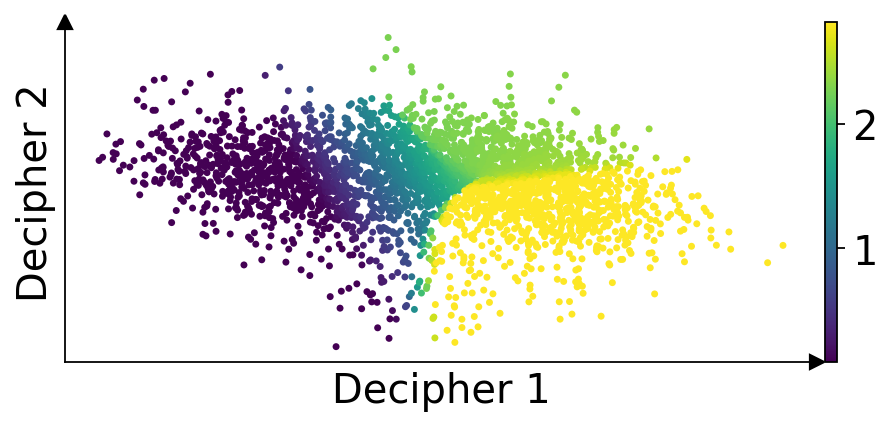

In [113]:
dc.pl.decipher_time(NTC,figsize=(6, 3))

plt.tight_layout() 
plt.savefig(os.path.join(figure_dir, 'dose_deciphertime.png'), dpi=300)
plt.savefig(os.path.join(figure_dir, 'dose_deciphertime.svg'), dpi=300)

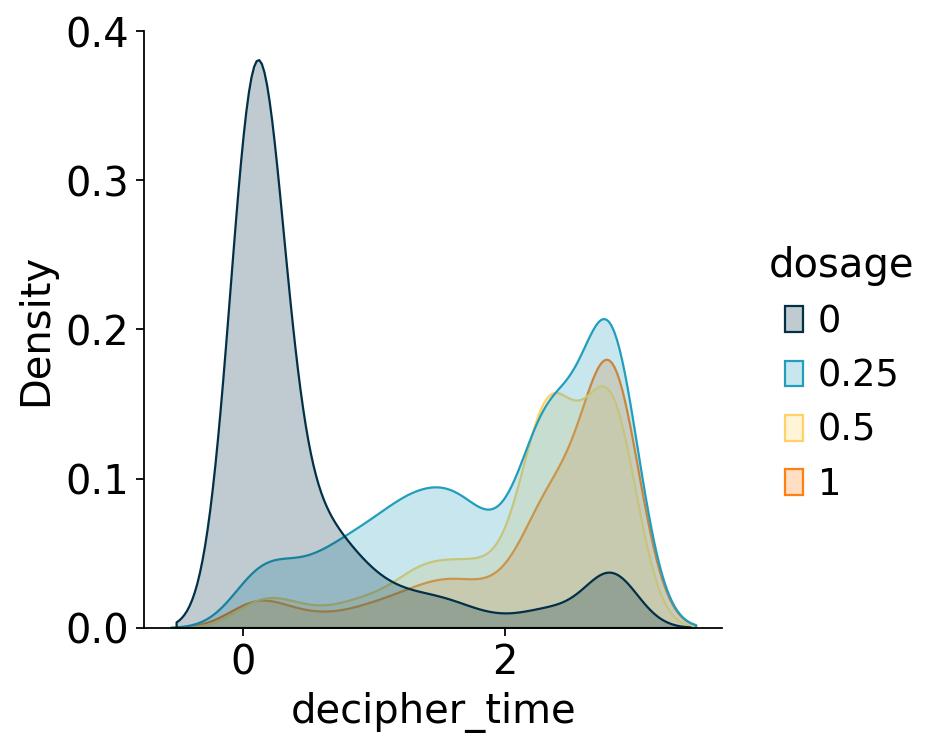

In [114]:
data = pd.DataFrame()
data['dosage'] = NTC.obs['dosage']
data['decipher_1'] = NTC.obsm['decipher_v'][:,0]
data['decipher_2'] = NTC.obsm['decipher_v'][:,1]
data['decipher_time'] = NTC.obs['decipher_time']

# Plot density plots for different categories
g = sns.displot(data, x="decipher_time", hue="dosage", kind="kde", fill=True, palette=dosage_colors)
plt.savefig(os.path.join(figure_dir, 'traj_displot.png'), dpi=300)
plt.savefig(os.path.join(figure_dir, 'traj_displot.svg'), dpi=300)

In [115]:
dc.tl.gene_patterns(NTC)

/burg/iicd/users/qc2358/decipher/decipher/tools/_decipher/data.py:85: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(os.path.join(full_path, 

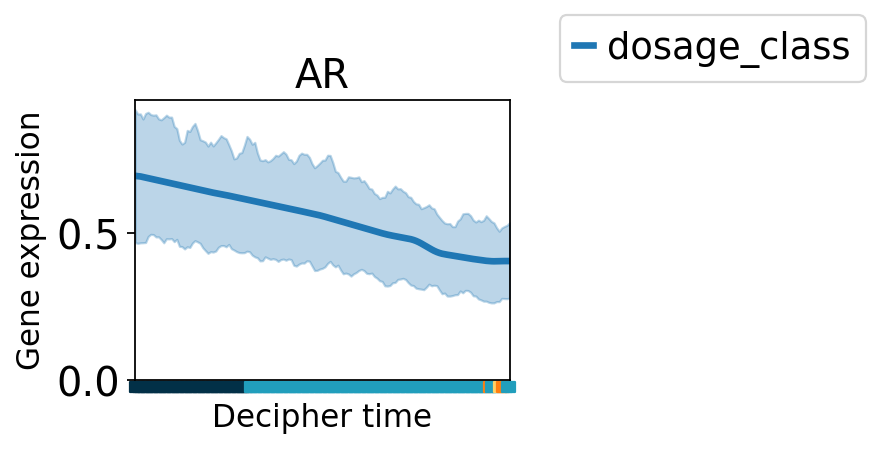

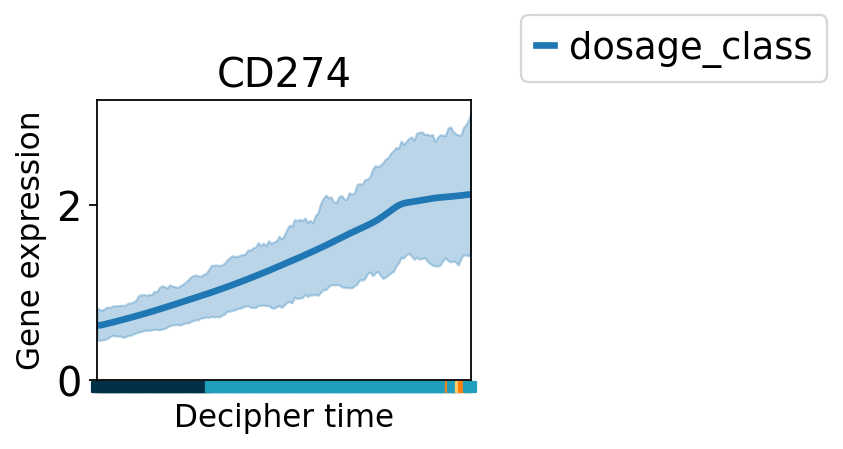

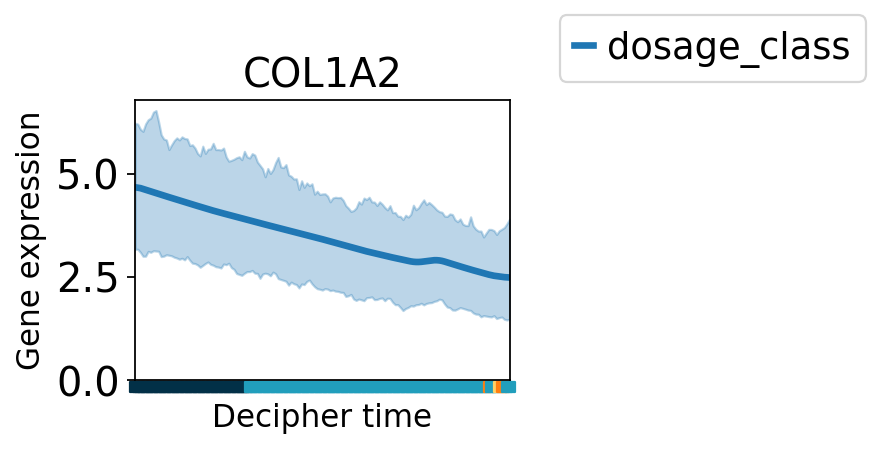

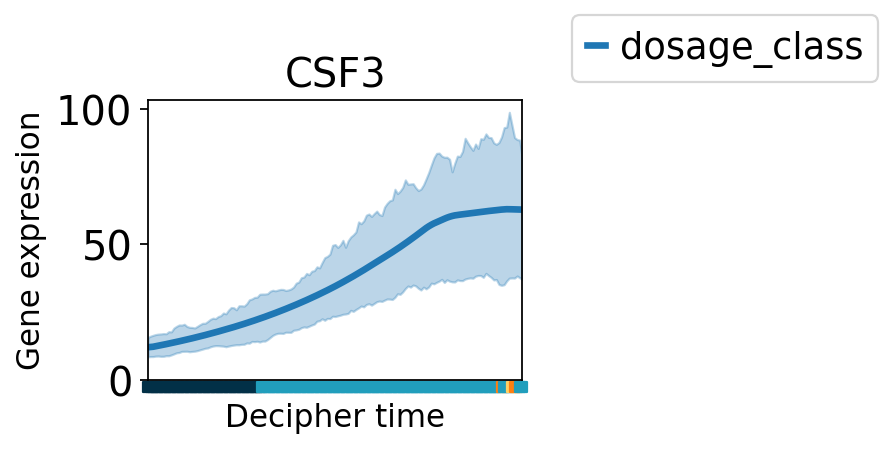

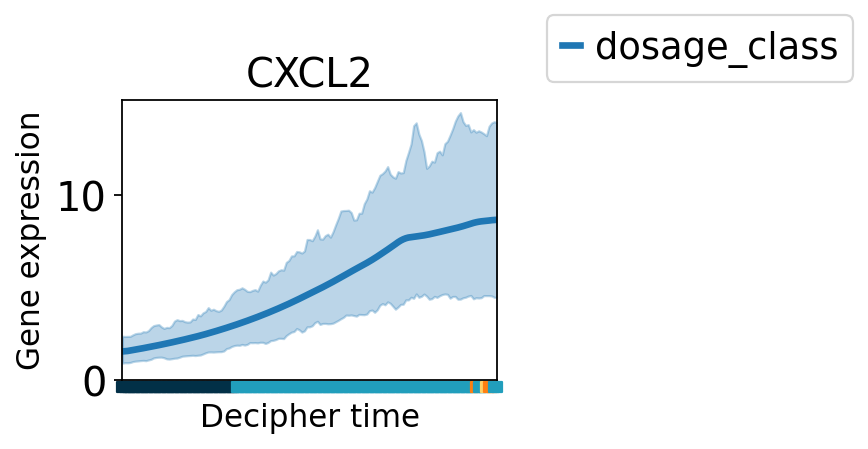

...

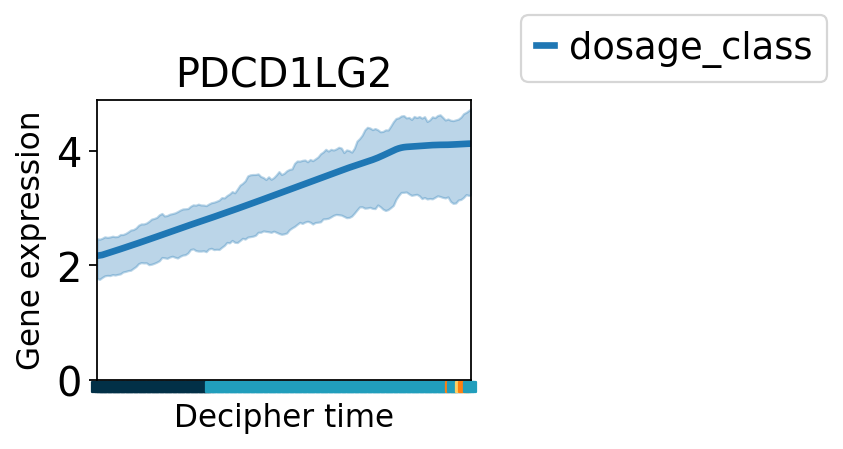

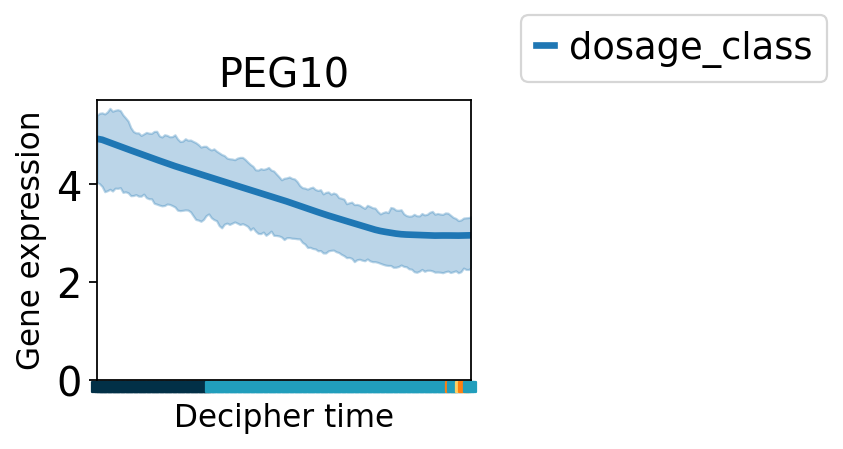

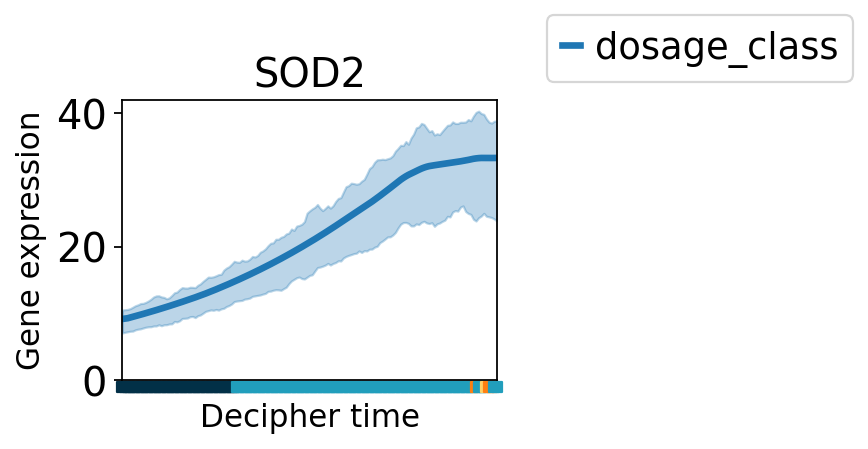

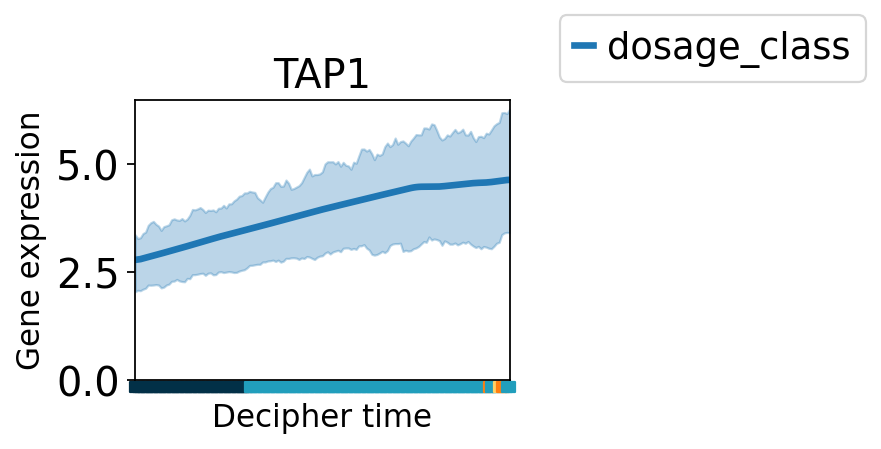

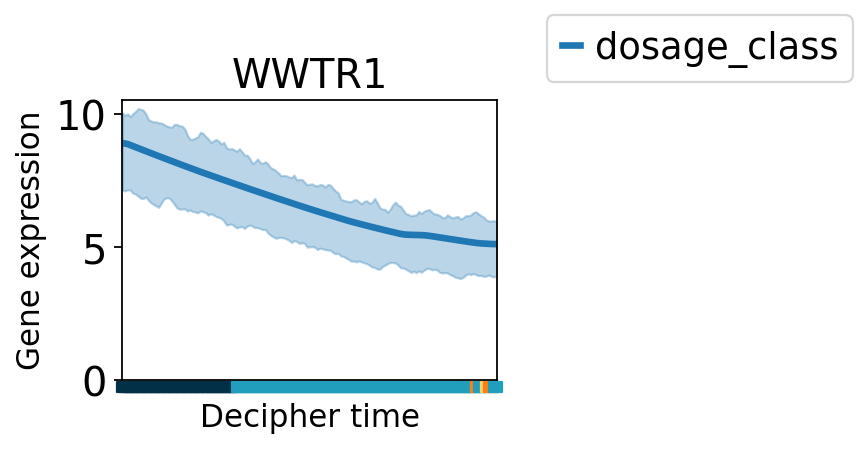

In [116]:
gene_list = ['SOD2','CSF3','IDO1','CD274','PDCD1LG2','PEG10','AR','WWTR1','ID1','CXXC5','COL1A2','TAP1','ICAM1','CXCL3','CXCL2','CXCL8']
gene_list = np.intersect1d(gene_list, NTC.var_names)

for i in gene_list:
    dc.pl.gene_patterns(NTC, i, palette=dosage_colors, cell_type_key="dosage")
    plt.legend(loc='lower right', bbox_to_anchor=(2, 1))
    plt.savefig(os.path.join(figure_dir, i + '_full_expression_plot.png'), dpi=300, bbox_inches='tight')
    plt.savefig(os.path.join(figure_dir, i + '_full_expression_plot.svg'), dpi=300, bbox_inches='tight')
    plt.show()

... storing 'P7' as categorical
... storing 'P5' as categorical
... storing 'sample' as categorical
... storing 'RT' as categorical
... storing 'Lig' as categorical
... storing 'oligo' as categorical
... storing 'treatment' as categorical
... storing 'sgRNA' as categorical
... storing 'top_sg' as categorical
... storing 'second_sg' as categorical
... storing 'third_sg' as categorical
... storing 'gene' as categorical
... storing 'second_sg_gene' as categorical
... storing 'third_sg_gene' as categorical
... storing 'RT_lig' as categorical
... storing 'gene_id' as categorical
... storing 'replicate' as categorical


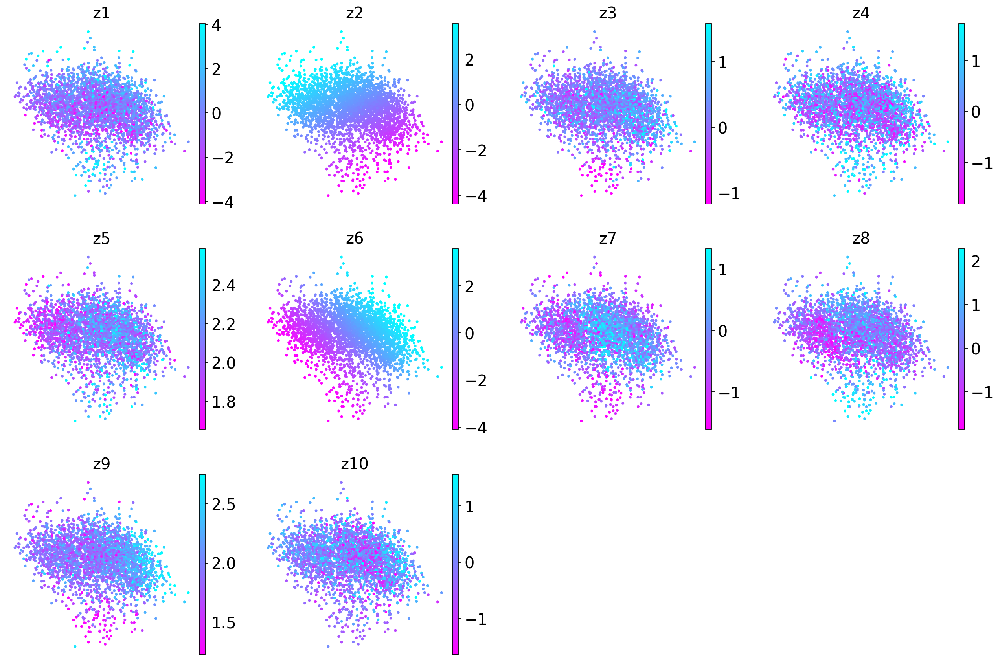

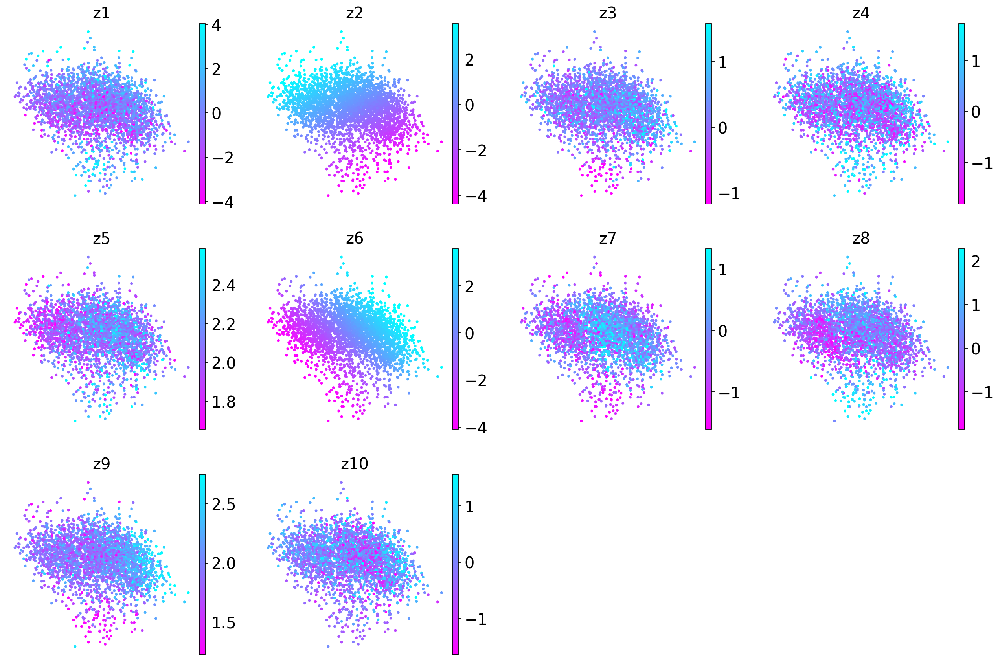

In [107]:
dc.pl.decipher_z(NTC)

In [108]:
NTC.raw.var.rename(columns={'_index':'index'},inplace=True) 
NTC.write(os.path.join(figure_dir, 'NTC_TCDG_Decipher.h5ad'))